<a href="https://colab.research.google.com/github/evmpython/CAT010_UNIFEI_2024/blob/main/CAT010_Aula_01_imagens_GOES16.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Disciplina CAT010** - Aplicações dos Satélites em Ciências Atmosféricas


---






## **Aula Prática 1:** $\underline{Plotando\ Imagem\ de\ Satélite}$
---
**OBJETIVO:** Nesta aula prática aprenderemos como plotar as imagens do canal **visível**, **vapor d'água** e também do **infravermelho**. Para isto usaremos os dados do sensor [Advanced Baseline Imager (ABI)](https://space.oscar.wmo.int/instruments/view/abi) do satélite [Geostationary Operational Environmental Satellite (GOES-16)](https://space.oscar.wmo.int/satellites/view/goes_16).

---


**DADOS DE ENTRADA**: Serão utilizadados os dados da NOAA disponibilizados no repositório da [Amazon](https://noaa-goes16.s3.amazonaws.com/index.html#ABI-L2-CMIPF/) e [CPTEC/INPE](http://ftp.cptec.inpe.br/goes/goes16/retangular)



Exemplo dos dados do CPTEC/INPE:

1. $\underline{Visível}$: CH02 - 0.64 µm
- **Tipo do dado:** matriz de 6262 linhas x 6262 colunas  
- **Formato do dado:** arquivo NETCDF
- **Nome do arquivo:** S10635334_202001231200.nc
- **Fonte dos dados:** FTP do [CPTEC/INPE](http://ftp.cptec.inpe.br/goes/goes16/retangular/ch02/)

    ----------

2. $\underline{Vapor\ d'água}$: CH08 - 6.15 µm
- **Tipo do dado:** matriz de 3131 linhas x 3131 colunas  
- **Formato do dado:** arquivo NETCDF
- **Nome do arquivo:** S10635340_202001231200.nc
- **Fonte dos dados:** FTP do [CPTEC/INPE](http://ftp.cptec.inpe.br/goes/goes16/retangular/ch08/)

    ----------

3. $\underline{Infravermelho}$: CH13 - 10.35 µm
- **Tipo do dado:** matriz de 3131 linhas x 3131 colunas  
- **Formato do dado:** arquivo NETCDF
- **Nome do arquivo:** S10635346_202001231200.nc
- **Fonte dos dados:** FTP do [CPTEC/INPE](http://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/)

---

**DADOS DE SAÍDA:** Figuras de temperatura de brilho e reflectância.
- **Tipo do dado:** Figura
- **Formato do dado:** arquivos PNG e JPG
- **Imagens geradas:**
    1. script_1_2024-04-30_13:00_UTC.png
    2. script_2_2024-04-30_13:00_UTC.png
    3. script_3_2024-04-30_13:00_UTC.png
    4. script_4a_2024-04-30_13:00.jpg
    5. script_4b_2024-04-30_13:00.jpg
    6. script_4c_2024-04-30_13:00.jpg
    7. script_5_2024-04-30_13:00.jpg
    8. script_6_2024-04-30_13:00.jpg
    9. script_6_animacao_imagens.gif
    10. script_7_painel.jpg
     

---

**PROCEDIMENTO REALIZADO:** Os seguintes procedimentos são realizados nesse código:
1.   **1° Passo:** Preparando o Ambiente para os `Scripts 1 ao 3`
2.   **Script 01** - Projeção Satélite e Imagem em Níveis de Cinza
3.   **Script 02** - Projeção Retangular e Imagem em Níveis de Cinza
4.   **Script 03** - Projeção Retangular com Realce
5.   **2° Passo:** Preparando o Ambiente para os `Scripts 4 ao 7`
6.   **Script 04** - Plotando os canais VIS, IR, WV com os dados do INPE - *Individuais*
7.   **Script 05** - Plotando o canal IR + VIS + WV com os dados do INPE - *Painel*
8.   **Script 06** - Plotando várias imagens do IR e criando animação
9.   **Script 07** - Plotando painel de imagens do IR


---
**OBSERVAÇÕES IMPORTANTES**:
1. Nenhuma observação.

---
- **Realizado por:** Diego Souza/INPE e Enrique V. Mattos - 19/08/2024
- **Atualizado por:** Enrique V. Mattos - 04/09/2024


---

# **1° Passo:** Preparando o Ambiente para os `Scripts 1 ao 3`

## **a) Instalando as Bibliotecas Necessárias**


Neste passo instalaremos as bibliotecas necessárias (e suas dependências) para a execução dos scripts. Basicamente, as bibliotecas terão a seguinte finalidade:

*   **Netcdf4 e Xarray:** Ler os dados de arquivos no formato NetCDF
*   **Cartopy:** Adicionar mapas aos plots
*   **Boto3:** Download de dados GOES-16 diretamente da nuvem - Amazon Web Services (AWS)
*   **GDAL:** Reprojeção de imagens GOES-16

In [ ]:
!pip install -q "numpy<2.0" netcdf4 xarray cartopy boto3 gdal

## **b) Download de Arquivos Auxiliares**

Neste passo vamos baixar alguns arquivos auxiliares necessários para parte dos scripts que serão demonstrados no curso:

*   **utilities.py:** Script com algumas funções para processamento de dados de satélite
*   **ir.cpt:** Paleta de cores para o canal do infravermelhos do GOES-16

In [ ]:
# importa biblioteca que contabiliza o tempo de processamento
import time

# Download do arquivo "utilities.py"
!wget -c https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/utils/utilities.py

# Download da paleta de cores para o canal do infravermelho
!wget -c https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/utils/ir.cpt

--2024-09-04 20:01:43--  https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/utils/utilities.py
Resolving github.com (github.com)... 140.82.112.4
Connecting to github.com (github.com)|140.82.112.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/evmpython/CAT010_UNIFEI_2024/main/utils/utilities.py [following]
--2024-09-04 20:01:43--  https://raw.githubusercontent.com/evmpython/CAT010_UNIFEI_2024/main/utils/utilities.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.108.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 416 Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

--2024-09-04 20:01:43--  https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/utils/ir.cpt
Resolving github.com (github.com)... 140.82.114.3
Connecting to 

#**Script 01** - Projeção Satélite e Imagem em Níveis de Cinza



Neste primeiro script vamos acessar e processar um arquivo NetCDF do sensor ABI do satélite GOES-16 e visualizar a imagem na projeção original (conhecida como projeção "GOES-R" ou "satélite"). Temos basicamente 5 "blocos" de código:

**1. Importação das bibliotecas necessárias**

**2. Criação de diretórios de entrada e saída de dados**

**3. Download de dados do sensor ABI do GOES-16**

**4. Leitura do aquivo NetCDF do sensor ABI**

**5. Criação da figura**

O que podemos modificar facilmente?

**1. Data e hora do arquivo a ser baixado**

**2. Qual canal ABI desejamos baixar**

**3. Escala de cores ([colormaps](https://matplotlib.org/stable/users/explain/colors/colormaps.html) padrão da matplotlib), título, entre outras decorações da imagem**

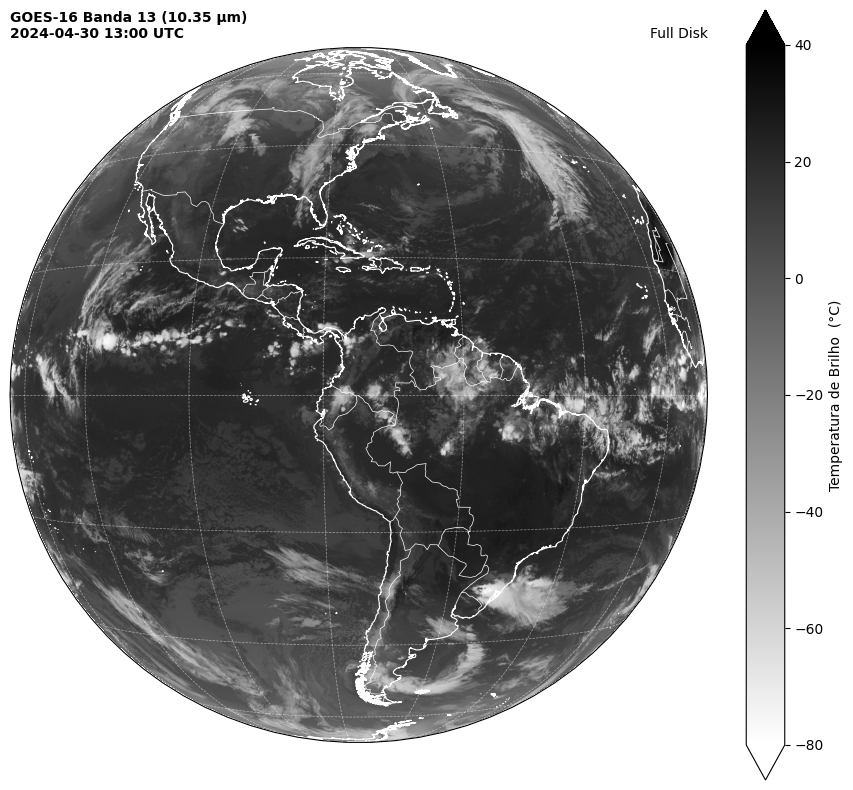

CPU times: user 20.8 s, sys: 1.96 s, total: 22.7 s
Wall time: 25.3 s


In [ ]:
%%time
#========================================================================================================================#
#                                          IMPORTAÇÃO DAS BIBLIOTECAS
#========================================================================================================================#
import xarray as xr
import matplotlib.pyplot as plt
import cartopy, cartopy.crs as ccrs
from datetime import datetime
from utilities import download_CMI
import os

#========================================================================================================================#
#                                        CRIA DIRETÓRIO DE ENTRADA E SAÍDA
#========================================================================================================================#
input = "/content/input"; os.makedirs(input, exist_ok=True)
output = "/content/output"; os.makedirs(output, exist_ok=True)

#========================================================================================================================#
#                                               DOWNLOAD DO ARQUIVO
#========================================================================================================================#
# data de processamento
yyyymmddhhmn = '202404301300'

# canal do ABI
band = '13'

# download do arquivo (CMI: "Cloud and Moisture Imagery" Product)
file_name = download_CMI(yyyymmddhhmn, band, input)

# caminho do arquivo que foi baixado
path = f'{input}/{file_name}.nc'

#========================================================================================================================#
#                                               LEITURA DO ARQUIVO
#========================================================================================================================#
# abre a imagem
data = xr.open_dataset(path)

#========================================================================================================================#
#                                                 PLOTA A IMAGEM
#========================================================================================================================#
# tamanho da figura (largura x altura em polegadas)
plt.figure(figsize=(10,10))

# usa a projeção geoestacionária do cartopy
# para o GOES-16: longitude central: -75.0 / altura do satellite: 35786023.0
# a extensão do Full Disk: (metade dos pixels full disk) X (tamanho do pixel em radianos) X (altura do satélite em metros) => 2712 * 0.000056 * 35786023.0 = 5434894.67527
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=-75.0, satellite_height=35786023.0))
img_extent = (-5434894.67527, 5434894.67527, -5434894.67527, 5434894.67527)

# linhas costeiras, bordas e linhas de grade do mapa
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
ax.gridlines(color='white', alpha=0.5, linestyle='--', linewidth=0.5)

# escala de cores
colormap = "gray_r" # escala de cores na ordem reversa - branco para preto para o canal do IR

# plota imagem
img = ax.imshow(data['CMI'] - 273.15, origin='upper', vmin=-80, vmax=40, extent=img_extent, cmap=colormap)

# barra de cores
plt.colorbar(img, label='Temperatura de Brilho (°C)', extend='both', orientation='vertical', pad=0.05, fraction=0.05)

# leitura da data/horário do arquivo NetCDF como uma string
date = (datetime.strptime(data.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')).strftime('%Y-%m-%d %H:%M UTC')

# título da figura
plt.title(f'GOES-16 Banda 13 (10.35 µm)\n{date}', fontweight='bold', fontsize=10, loc='left')
plt.title('Full Disk', fontsize=10, loc='right')

# salva figura
plt.savefig(f'{output}/script_1_{date.replace(" ", "_")}.png')

# mostra figura na tela
plt.show()

#**Script 02** - Projeção Retangular e Imagem em Níveis de Cinza


Neste segundo script vamos reprojetar a imagem ABI, da projeção GOES-R para a projeção "cilíndrica equidistante" utilizando uma função chamada "remap", que utiliza a biblioteca GDAL (https://gdal.org/api/python_bindings.html). O dado reprojetado será visualizado em escala de cinza invertida (branco para temperaturas de brilho mais baixas e preto para temperaturas de brilho mais altas).

O que podemos modificar facilmente?

**1. A região desejada (variável "extent")**

File /content/input/OR_ABI-L2-CMIPF-M6C13_G16_s20241211300205_e20241211309524_c20241211309588.nc exists
Remapping...
Remap finished! Time: 0.74 seconds


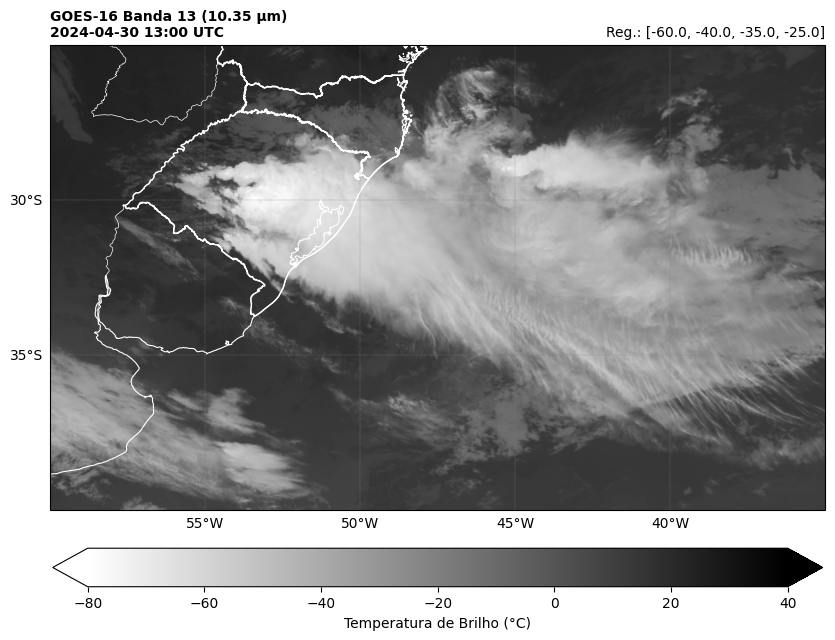

CPU times: user 9.21 s, sys: 1.24 s, total: 10.5 s
Wall time: 12.3 s


In [ ]:
%%time
#========================================================================================================================#
#                                          IMPORTAÇÃO DAS BIBLIOTECAS
#========================================================================================================================#
import xarray as xr
import matplotlib.pyplot as plt
import cartopy, cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
from datetime import datetime
from utilities import download_CMI, remap
import numpy as np
import os

#========================================================================================================================#
#                                        CRIA DIRETÓRIO DE ENTRADA E SAÍDA
#========================================================================================================================#
input = "/content/input"; os.makedirs(input, exist_ok=True)
output = "/content/output"; os.makedirs(output, exist_ok=True)

#========================================================================================================================#
#                                               DOWNLOAD DO ARQUIVO
#========================================================================================================================#
# data de processamento
yyyymmddhhmn = '202404301300'

# canal do ABI
band = '13'

# download do arquivo (CMI: "Cloud and Moisture Imagery" Product)
file_name = download_CMI(yyyymmddhhmn, band, input)

# caminho do arquivo que foi baixado
path = f'{input}/{file_name}.nc'

#========================================================================================================================#
#                                         REPROJETA E FAZ A LEITURA DO ARQUIVO
#========================================================================================================================#
# área desejada (min lon, min lat, max lon, max lat)
extent = [-60.00, -40.00, -35.00, -25.00]

# chama a função que faz a reprojeção (file, variable, extent, resolution)
grid = remap(path, 'CMI', extent, 2)

# leitura do dado e transforma para °C
data = grid.ReadAsArray() - 273.15

#========================================================================================================================#
#                                                 PLOT THE IMAGE
#========================================================================================================================#
# tamanho da figura (largura x altura em polegadas)
plt.figure(figsize=(10,10))

# projeção geoestacionária do cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# define a extensão da imagem
img_extent = [extent[0], extent[2], extent[1], extent[3]] # Min lon, Max lon, Min lat, Max lat

# escala de cores
colormap = "gray_r" # escala de cores na ordem reversa - branco para preto para o canal do IR

# plota imagem
img = ax.imshow(data, origin='upper', vmin=-80, vmax=40, extent=img_extent, cmap=colormap)

# linhas costeiras, bordas e linhas de grade do mapa
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False
gl.right_labels = False

# plota estados
shapefile = list(shpreader.Reader('https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/shapefiles/BR_UF_2019.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='white', facecolor='none', linewidth=1.0)

# barra de cores
plt.colorbar(img, label='Temperatura de Brilho (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# leitura da data/horário do arquivo NetCDF como uma string
date = (datetime.strptime(xr.open_dataset(path).time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')).strftime('%Y-%m-%d %H:%M UTC')

# título da figura
plt.title(f'GOES-16 Banda 13 (10.35 µm)\n{date}', fontweight='bold', fontsize=10, loc='left')
plt.title('Reg.: ' + str(extent) , fontsize=10, loc='right')

# salva figura
plt.savefig(f'{output}/script_2_{date.replace(" ", "_")}.png', bbox_inches='tight', dpi=300)

# mostra figura na tela
plt.show()

#**Script 03** - Projeção Retangular com Realce


Neste terceiro script vamos reprojetar a imagem e visualizá-la em escala colorida, realçando a imagem IR. Para isso, vamos utilizar a função **"loadCPT"**, criada para carregar uma paleta de cores no formato de arquivo ".cpt". Podemos acessar dezenas de escalas neste formato na seguinte página: http://seaviewsensing.com/pub/cpt-city/

File /content/input/OR_ABI-L2-CMIPF-M6C13_G16_s20241211300205_e20241211309524_c20241211309588.nc exists
Remapping...
Remap finished! Time: 0.39 seconds


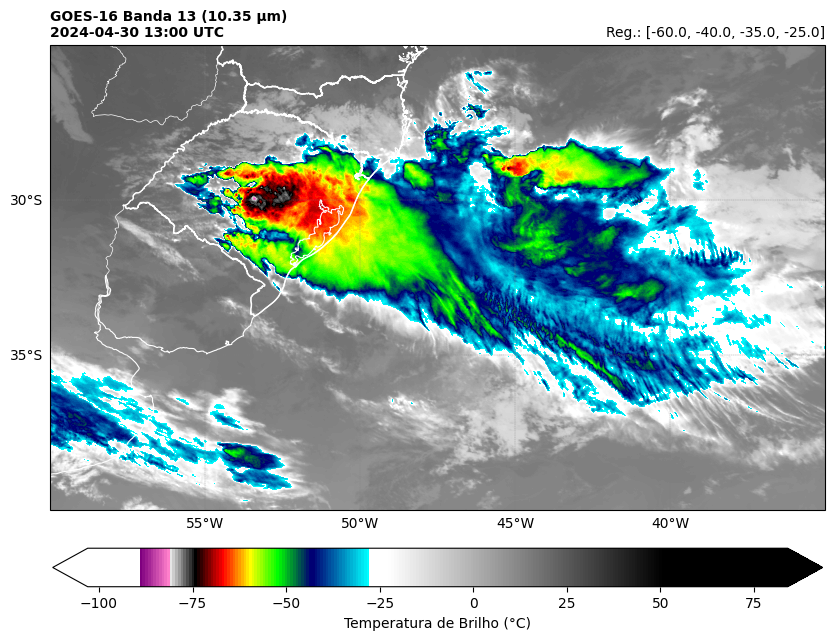

CPU times: user 8.25 s, sys: 971 ms, total: 9.22 s
Wall time: 8.31 s


In [ ]:
%%time
#========================================================================================================================#
#                                          IMPORTAÇÃO DAS BIBLIOTECAS
#========================================================================================================================#
import xarray as xr
import matplotlib.pyplot as plt
from matplotlib import cm
import cartopy, cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
from datetime import datetime
from utilities import download_CMI, remap, loadCPT
import numpy as np
import os

#========================================================================================================================#
#                                        CRIA DIRETÓRIO DE ENTRADA E SAÍDA
#========================================================================================================================#
input = "/content/input"; os.makedirs(input, exist_ok=True)
output = "/content/output"; os.makedirs(output, exist_ok=True)

#========================================================================================================================#
#                                               DOWNLOAD DO ARQUIVO
#========================================================================================================================#
# data de processamento
yyyymmddhhmn = '202404301300'

# canal do ABI
band = '13'

# download do arquivo (CMI: "Cloud and Moisture Imagery" Product)
file_name = download_CMI(yyyymmddhhmn, band, input)

# caminho do arquivo que foi baixado
path = f'{input}/{file_name}.nc'

#========================================================================================================================#
#                                         REPROJETA E FAZ A LEITURA DO ARQUIVO
#========================================================================================================================#
# área desejada (min lon, min lat, max lon, max lat)
extent = [-60.00, -40.00, -35.00, -25.00]

# chama a função que faz a reprojeção (file, variable, extent, resolution)
grid = remap(path, 'CMI', extent, 2)

# leitura do dado e transforma para °C
data = grid.ReadAsArray() - 273.15

#========================================================================================================================#
#                                                 PLOT THE IMAGE
#========================================================================================================================#
# tamanho da figura (largura x altura em polegadas)
plt.figure(figsize=(10,10))

# projeção geoestacionária do cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# define a extensão da imagem
img_extent = [extent[0], extent[2], extent[1], extent[3]] # Min lon, Max lon, Min lat, Max lat

# converte o arquivo CPT para ser usado em Python
cpt = loadCPT('ir.cpt')
colormap = cm.colors.LinearSegmentedColormap('cpt', cpt)

# plota imagem
img = ax.imshow(data, origin='upper', vmin=-103.0, vmax=84, extent=img_extent, cmap=colormap)

# linhas costeiras, bordas e linhas de grade do mapa
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cartopy.feature.BORDERS, edgecolor='white', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False
gl.right_labels = False

# plota estados
shapefile = list(shpreader.Reader('https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/shapefiles/BR_UF_2019.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='white', facecolor='none', linewidth=1.0)

# barra de cores
plt.colorbar(img, label='Temperatura de Brilho (°C)', extend='both', orientation='horizontal', pad=0.05, fraction=0.05)

# leitura da data/horário do arquivo NetCDF como uma string
date = (datetime.strptime(xr.open_dataset(path).time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')).strftime('%Y-%m-%d %H:%M UTC')

# título da figura
plt.title(f'GOES-16 Banda 13 (10.35 µm)\n{date}', fontweight='bold', fontsize=10, loc='left')
plt.title('Reg.: ' + str(extent) , fontsize=10, loc='right')

# salva figura
plt.savefig(f'{output}/script_3_{date.replace(" ", "_")}.png', bbox_inches='tight', dpi=300)

# mostra figura na tela
plt.show()

# **2° Passo:** Preparando o Ambiente para os `Scripts 4 ao 7`



---


A ideia dos scripts 4 ao 7 é usarmos os dados em formato de projeção retangular fornecidos pelo CPTEC/INPE.

- Esses dados são fornecidos pela NOAA e reprocessados pela [Divisão de Satélites (DSA)](http://satelite.cptec.inpe.br/home/index.jsp) do CPTEC/INPE e estão disponíveis no [ftp](http://ftp.cptec.inpe.br/goes/goes16/retangular/) do INPE. Abaixo seguem informações sobres esses 3 canais:



---

1. [Visível](http://ftp.cptec.inpe.br/goes/goes16/retangular/ch02/): CH02 - 0.64 µm
2. [Vapor d'água](http://ftp.cptec.inpe.br/goes/goes16/retangular/ch08/): CH08 - 6.15 µm
3. [Infravermelho](http://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/): CH13 - 10.35 µm

---

## a) Instalando as Bibliotecas Necessárias


Neste passo instalamos as bibliotecas necessárias (e suas dependências) para a execução dos scripts. Basicamente, as bibliotecas terão a seguinte finalidade:

*   **Proplot:** Plota mapas

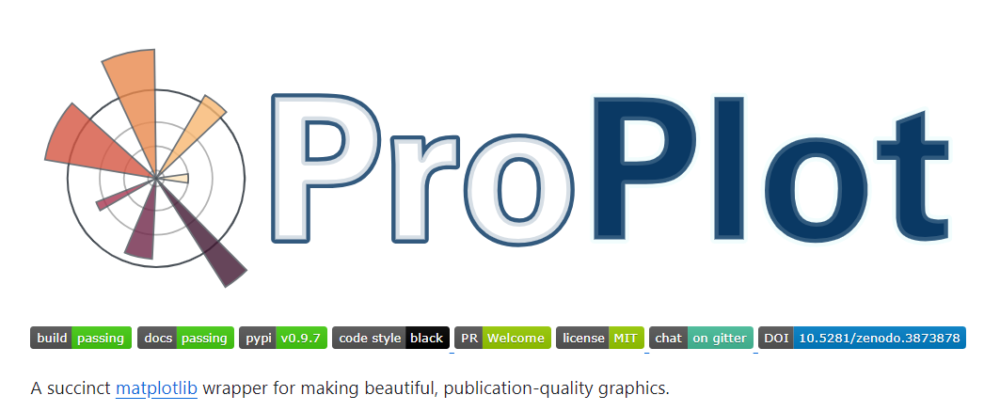

O [ProPlot](https://github.com/proplot-dev/proplot) é uma biblioteca criada por [**Luke Davis**](https://github.com/lukelbd) do Departamento de Ciências Atmosféricas da **Colorado University** para produzir gráficos de alta qualidade. A grande vantagem do ProPlot em relação ao Cartopy para plotar mapas é a sua sintaxe sucinta e a alta qualidade dos gráficos. Para maiores informações sobre o ProPlot acesse:

- Pypi: https://pypi.org/project/proplot/

- GitHub: https://github.com/proplot-dev/proplot

- Documentação: https://proplot.readthedocs.io/en/stable/

- Exemplos: https://proplot.readthedocs.io/en/stable/1dplots.html

A instalação da biblioteca proplot e das suas dependências demora aproximadamente 4 min.

In [ ]:
# Instalando o proplot (usado para gerar Mapas também)
!pip install -q proplot

# Instalando o cartopy (usado para gerar Mapas)
!pip uninstall shapely --yes
!pip install -q shapely cartopy==0.21.1 --no-binary shapely --no-binary cartopy
!wget https://raw.githubusercontent.com/SciTools/cartopy/master/tools/cartopy_feature_download.py
!python cartopy_feature_download.py physical

Found existing installation: shapely 2.0.6
Uninstalling shapely-2.0.6:
  Successfully uninstalled shapely-2.0.6
--2024-09-04 21:02:31--  https://raw.githubusercontent.com/SciTools/cartopy/master/tools/cartopy_feature_download.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 404 Not Found
2024-09-04 21:02:31 ERROR 404: Not Found.

python3: can't open file '/content/cartopy_feature_download.py': [Errno 2] No such file or directory


- Devido a um conflito entre o Proplot e algumas bibliotecas, teremos que reiniciar nossa sessaão do Colab.

- Para isto, você deverá acessar a aba denominada de `Ambiente de execução`, localizada na barra de ferramentas e clicar em `Reiniciar Sessão` e depois rodar a célula anterior de instalação novamente. Importante salientar que ao realizar esse procedimento, tudo que foi realizado anteriormente foi excluído do nosso ambiente de trabalho do Colab. Então a partir desse ponto não teremos mais que nos preocupar com a preparação do ambiente virtual para utilizar a biblioteca proplot.

## b) Download de Arquivos Auxiliares

Neste passo vamos baixar alguns arquivos auxiliares necessários para a parte dos scripts que serão demonstrados no curso:

*   **utilities.py:** Script com algumas funções para processamento de dados de satélite
*   **ir.cpt:** Paleta de cores para canais infravermelhos do GOES-16
*   **vis.cpt:** Paleta de cores para o canal do visível do GOES-16
*   **wv.cpt:** Paleta de cores para o canal do vapor d'água do GOES-16

In [ ]:
# baixando o arquivo utilities.py
!wget -c https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/utils/utilities.py

# baixando a paletas de cores do infravermelho, visível e vapor d'água
!wget -c https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/utils/ir.cpt
!wget -c https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/utils/vis.cpt
!wget -c https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/utils/wv.cpt

--2024-09-04 21:02:41--  https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/utils/utilities.py
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/evmpython/CAT010_UNIFEI_2024/main/utils/utilities.py [following]
--2024-09-04 21:02:42--  https://raw.githubusercontent.com/evmpython/CAT010_UNIFEI_2024/main/utils/utilities.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.111.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 416 Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

--2024-09-04 21:02:42--  https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/utils/ir.cpt
Resolving github.com (github.com)... 140.82.113.4
Connecting to 

#**Script 04** - Plotando os canais VIS, IR, WV com os dados do INPE - *Individuais*


- A ideia desse script é vocês baixarem os dados brutos de satélite direto da fonte. Assim, o primeiro passo será baixar os dados de satélite para os canais visível, infravermelho e vapor d'água para uma determinada data.
- Esses dados são fornecidos pela NOAA e reprocessados pela [Divisão de Satélites (DSA)](http://satelite.cptec.inpe.br/home/index.jsp) do CPTEC/INPE e estão disponíveis no [ftp](http://ftp.cptec.inpe.br/goes/goes16/retangular/) do INPE. Abaixo seguem informações sobres esses 3 canais:



---

1. [Visível](http://ftp.cptec.inpe.br/goes/goes16/retangular/ch02/): CH02 - 0.64 µm
2. [Vapor d'água](http://ftp.cptec.inpe.br/goes/goes16/retangular/ch08/): CH08 - 6.15 µm
3. [Infravermelho](http://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/): CH13 - 10.35 µm

---

Abaixo precisaremos definir o **ano**, **mês**, **dia**, **hora** e **minuto** do dado que gostaríamos de gerar a imagem de satélite. **Lembre-se**: os dados do sensor **ABI** do satélite **GOES-16** possui resolução temporal de 10 min. Por exemplo: 00:00, 00:10, 00:20, ... No exemplo a seguir iremos baixar e gerar a imagem do dia **23 de janeiro de 2020 às 17 horas e 0 minutos**.

## IR

In [ ]:
#========================================================================================================================#
#                                             IMPORTA AS BIBLIOTECAS
#========================================================================================================================#
import numpy as np
import proplot as pplt
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import cm
import cartopy, cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
import xarray as xr
import os
from utilities import loadCPT
import warnings
warnings.filterwarnings("ignore")

#========================================================================================================================#
#                                         CRIA PASTA DE ENTRADA E SAÍDA
#========================================================================================================================#
input = "/content/input"; os.makedirs(input, exist_ok=True)
output = "/content/output"; os.makedirs(output, exist_ok=True)

#========================================================================================================================#
#                                         DEFINE A DATA DO ARQUIVO DE SATÉLITE
#========================================================================================================================#
ano, mes, dia, hor, min = '2024', '04', '30', '13', '00'

#========================================================================================================================#
#                                         BAIXA O ARQUIVO DE SATÉLITE
#========================================================================================================================#
# endereço do FTP do CPTEC-INPE
ftp_cptec = 'http://ftp.cptec.inpe.br/goes/'

# montando os nomes dos arquivos. É o caminho onde estão os dados no ftp do INPE.
file_ir =  f'{ftp_cptec}goes16/retangular/ch13/{ano}/{mes}/S10635346_{ano}{mes}{dia}{hor}{min}.nc'

# mostra os nomes dos arquivos
print(file_ir)

# download dos arquivos
!wget -c {file_ir} -P /content/input/

http://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/2024/04/S10635346_202404301300.nc
--2024-09-04 21:06:36--  http://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/2024/04/S10635346_202404301300.nc
Resolving ftp.cptec.inpe.br (ftp.cptec.inpe.br)... 150.163.192.38
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/2024/04/S10635346_202404301300.nc [following]
--2024-09-04 21:06:37--  https://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/2024/04/S10635346_202404301300.nc
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.



In [ ]:
# leitura do arquivo
imagem = xr.open_dataset(f'/content/input/S10635346_{ano}{mes}{dia}{hor}{min}.nc')

In [ ]:
# mostra os dados
imagem

<xarray.Dataset> Size: 78MB
Dimensions:  (lat: 3131, lon: 3131)
Coordinates:
  * lat      (lat) float64 25kB -55.99 -55.96 -55.93 -55.9 ... 34.93 34.96 34.99
  * lon      (lon) float64 25kB -116.0 -116.0 -115.9 ... -25.07 -25.04 -25.01
Data variables:
    Band1    (lat, lon) float64 78MB ...
    crs      |S1 1B ...
Attributes:
    Conventions:  CF-1.5
    GDAL:         GDAL 2.2.2, released 2017/09/15
    history:      Tue Apr 30 13:16:43 2024: GDAL Create( /dados/output/goes16...

In [ ]:
# extrai os limites das latitudes e longitudes
latmin, latmax, lonmin, lonmax = float(imagem['lat'][0]), float(imagem['lat'][-1]), float(imagem['lon'][0]), float(imagem['lon'][-1])

In [ ]:
# divide por 100 e transforma para Celsius
imagem = (imagem['Band1']/100.)-273.15

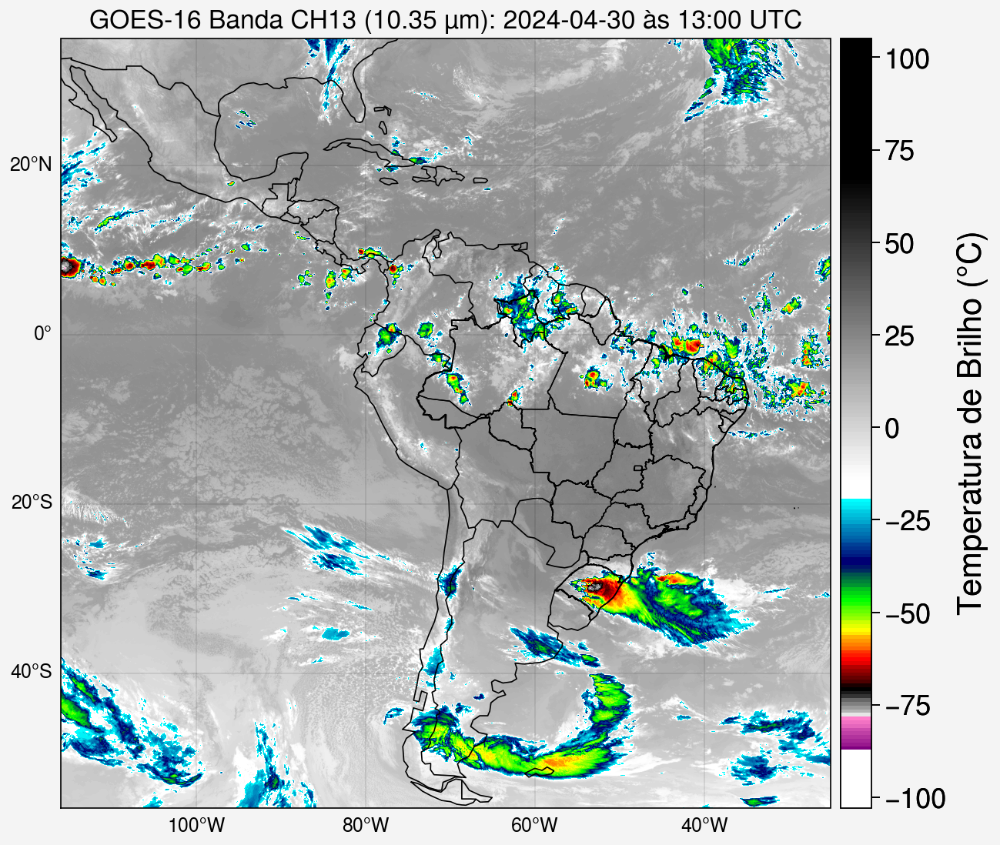

CPU times: user 9.08 s, sys: 796 ms, total: 9.87 s
Wall time: 9.32 s


In [ ]:
%%time
#========================================================================================================================#
#                                             PLOTA FIGURA
#========================================================================================================================#
# cria moldura da figura
fig, ax = pplt.subplots(axwidth=5, axheight=5, tight=True, proj='pcarree')

# define formatação dos eixos da figura
ax.format(coast=True, borders=True, innerborders=False,
          labels=True, latlines=20, lonlines=20,
          latlim=(latmin,latmax), lonlim=(lonmin,lonmax), fontsize=11,
          title=f'GOES-16 Banda CH13 (10.35 µm): {ano}-{mes}-{dia} às {hor}:{min} UTC')

# carrega tabela de cores
cpt_ir = loadCPT(f'/content/ir.cpt')
cmap_ir = cm.colors.LinearSegmentedColormap('cpt_ir', cpt_ir)

# plota mapa
map1 = ax.imshow(np.flipud(imagem),
                 cmap=cmap_ir,
                 extent=[lonmin, lonmax, latmin, latmax],
                 levels=pplt.arange(-103.0, 105, 1.0))

# plota contornos dos Estados
shapefile = list(shpreader.Reader('https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/shapefiles/BR_UF_2019.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='black', facecolor='none', linewidth=0.5)

# plota barra de cores da figura
fig.colorbar(map1, loc='r', label='Temperatura de Brilho ($\degree$C)', ticks=25, ticklabelsize=13, labelsize=15, space=0.5)

# salva figura
fig.save(f'/content/output/script_4a_{ano}-{mes}-{dia}_{hor}:{min}.jpg', dpi=300, bbox_inches='tight')

# exibe a figura na tela
pplt.show()

## VIS

In [ ]:
#========================================================================================================================#
#                                             IMPORTA AS BIBLIOTECAS
#========================================================================================================================#
import numpy as np
import proplot as pplt
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import cm
import cartopy, cartopy.crs as ccrs                # Plot maps
import cartopy.io.shapereader as shpreader         # Read shapefiles
import xarray as xr
from utilities import loadCPT # Our own utilities
import warnings
warnings.filterwarnings("ignore")

#========================================================================================================================#
#                                         CRIA PASTA DE ENTRADA E SAÍDA
#========================================================================================================================#
input = "/content/input"; os.makedirs(input, exist_ok=True)
output = "/content/output"; os.makedirs(output, exist_ok=True)

#========================================================================================================================#
#                                         DEFINE A DATA DO ARQUIVO DE SATÉLITE
#========================================================================================================================#
ano, mes, dia, hor, min = '2024', '04', '30', '13', '00'

#========================================================================================================================#
#                                         BAIXA O ARQUIVO DE SATÉLITE
#========================================================================================================================#
# endereço do FTP do CPTEC-INPE
ftp_cptec = 'http://ftp.cptec.inpe.br/goes/'

# montando os nomes dos arquivos. É o caminho onde estão os dados no ftp do INPE.
file_vis = f'{ftp_cptec}goes16/retangular/ch02/{ano}/{mes}/S10635334_{ano}{mes}{dia}{hor}{min}.nc'

# mostra os nomes dos arquivos
print(file_vis)

# download dos arquivos
!wget -c {file_vis} -P /content/input/

http://ftp.cptec.inpe.br/goes/goes16/retangular/ch02/2024/04/S10635334_202404301300.nc
--2024-09-04 21:19:36--  http://ftp.cptec.inpe.br/goes/goes16/retangular/ch02/2024/04/S10635334_202404301300.nc
Resolving ftp.cptec.inpe.br (ftp.cptec.inpe.br)... 150.163.192.38
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://ftp.cptec.inpe.br/goes/goes16/retangular/ch02/2024/04/S10635334_202404301300.nc [following]
--2024-09-04 21:19:36--  https://ftp.cptec.inpe.br/goes/goes16/retangular/ch02/2024/04/S10635334_202404301300.nc
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.



In [ ]:
# leitura do arquivo
imagem = xr.open_dataset(f'/content/input/S10635334_{ano}{mes}{dia}{hor}{min}.nc')

In [ ]:
# mostra os dados
imagem

<xarray.Dataset> Size: 314MB
Dimensions:  (lat: 6262, lon: 6262)
Coordinates:
  * lat      (lat) float64 50kB -55.99 -55.98 -55.96 ... 34.96 34.98 34.99
  * lon      (lon) float64 50kB -116.0 -116.0 -116.0 ... -25.04 -25.02 -25.01
Data variables:
    Band1    (lat, lon) float64 314MB ...
    crs      |S1 1B ...
Attributes:
    Conventions:  CF-1.5
    GDAL:         GDAL 2.2.2, released 2017/09/15
    history:      Tue Apr 30 13:19:08 2024: GDAL Create( /dados/output/goes16...

In [ ]:
# extrai os limites das latitudes e longitudes
latmin, latmax, lonmin, lonmax = float(imagem['lat'][0]), float(imagem['lat'][-1]), float(imagem['lon'][0]), float(imagem['lon'][-1])

In [ ]:
# divide por 100
imagem = (imagem['Band1']/100.)

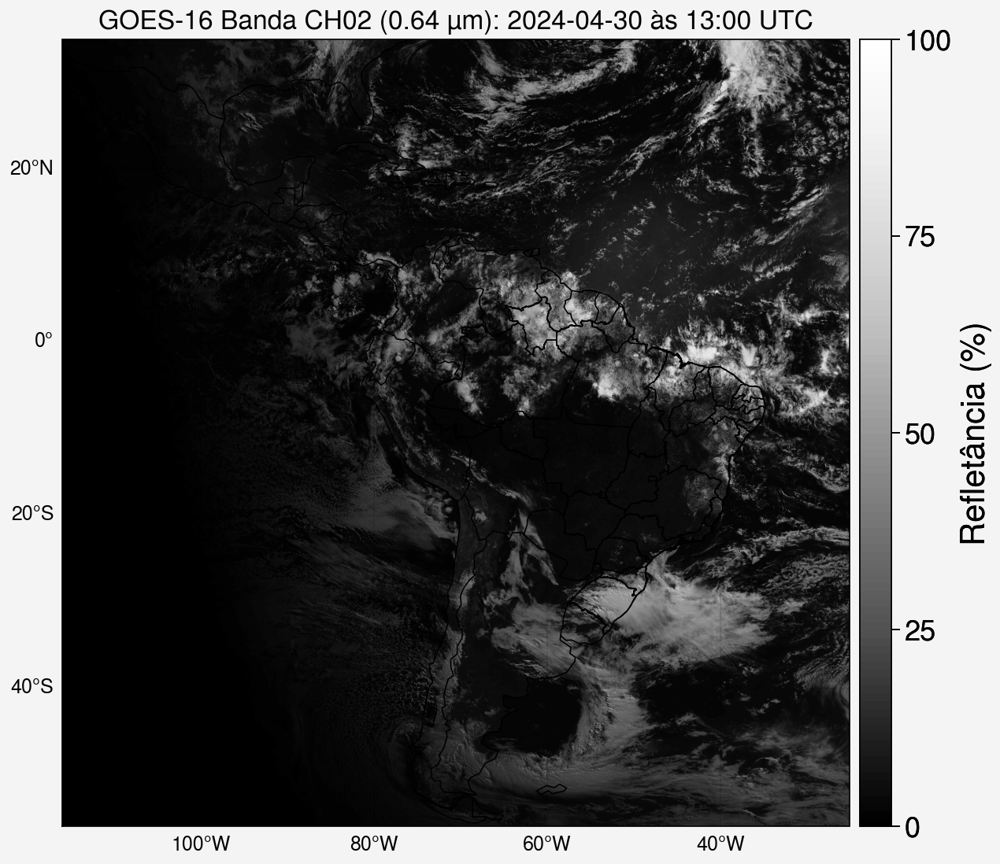

In [ ]:
# cria modura da figura
fig, ax = pplt.subplots(axwidth=5, axheight=5, tight=True, proj='pcarree')

# define formatação dos eixos da figura
ax.format(coast=True, borders=True, innerborders=False,
          labels=True, latlines=20, lonlines=20,
          latlim=(latmin,latmax), lonlim=(lonmin,lonmax), fontsize=11,
          title=f'GOES-16 Banda CH02 (0.64 µm): {ano}-{mes}-{dia} às {hor}:{min} UTC')

# plota mapa
map1 = ax.imshow(np.flipud(imagem),
                 cmap='Greys_r',
                 extent=[lonmin, lonmax, latmin, latmax],
                 levels=pplt.arange(0, 100, 1.0))

# plota contornos dos Estados
shapefile = list(shpreader.Reader('https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/shapefiles/BR_UF_2019.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='black', facecolor='none', linewidth=0.5)

# plota barra de cores da figura
fig.colorbar(map1, loc='r', label='Refletância (%)', ticks=25, ticklabelsize=13, labelsize=15, space=0.5)

# salva figura
fig.save(f'output/script_4b_{ano}-{mes}-{dia}_{hor}:{min}.jpg', dpi=300, bbox_inches='tight')

# exibe a figura na tela
pplt.show()

## WV

In [ ]:
#========================================================================================================================#
#                                             IMPORTA AS BIBLIOTECAS
#========================================================================================================================#
import numpy as np
import proplot as pplt
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import cm
import cartopy, cartopy.crs as ccrs                # Plot maps
import cartopy.io.shapereader as shpreader         # Read shapefiles
import xarray as xr
from utilities import loadCPT # Our own utilities
import warnings
warnings.filterwarnings("ignore")

#========================================================================================================================#
#                                         CRIA PASTA DE ENTRADA E SAÍDA
#========================================================================================================================#
input = "/content/input"; os.makedirs(input, exist_ok=True)
output = "/content/output"; os.makedirs(output, exist_ok=True)

#========================================================================================================================#
#                                         DEFINE A DATA DO ARQUIVO DE SATÉLITE
#========================================================================================================================#
ano, mes, dia, hor, min = '2024', '04', '30', '13', '00'

#========================================================================================================================#
#                                         BAIXA O ARQUIVO DE SATÉLITE
#========================================================================================================================#
# endereço do FTP do CPTEC-INPE
ftp_cptec = 'http://ftp.cptec.inpe.br/goes/'

# montando os nomes dos arquivos. É o caminho onde estão os dados no ftp do INPE.
file_wv =  f'{ftp_cptec}goes16/retangular/ch08/{ano}/{mes}/S10635340_{ano}{mes}{dia}{hor}{min}.nc'

# mostra os nomes dos arquivos
print(file_wv)

# download dos arquivos
!wget -c {file_wv} -P /content/input/

http://ftp.cptec.inpe.br/goes/goes16/retangular/ch08/2024/04/S10635340_202404301300.nc
--2024-09-04 21:23:36--  http://ftp.cptec.inpe.br/goes/goes16/retangular/ch08/2024/04/S10635340_202404301300.nc
Resolving ftp.cptec.inpe.br (ftp.cptec.inpe.br)... 150.163.192.38
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://ftp.cptec.inpe.br/goes/goes16/retangular/ch08/2024/04/S10635340_202404301300.nc [following]
--2024-09-04 21:23:37--  https://ftp.cptec.inpe.br/goes/goes16/retangular/ch08/2024/04/S10635340_202404301300.nc
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.



In [ ]:
# leitura do arquivo
imagem = xr.open_dataset(f'/content/input/S10635340_{ano}{mes}{dia}{hor}{min}.nc')

In [ ]:
# mostra os dados
imagem

<xarray.Dataset> Size: 78MB
Dimensions:  (lat: 3131, lon: 3131)
Coordinates:
  * lat      (lat) float64 25kB -55.99 -55.96 -55.93 -55.9 ... 34.93 34.96 34.99
  * lon      (lon) float64 25kB -116.0 -116.0 -115.9 ... -25.07 -25.04 -25.01
Data variables:
    Band1    (lat, lon) float64 78MB ...
    crs      |S1 1B ...
Attributes:
    Conventions:  CF-1.5
    GDAL:         GDAL 2.2.2, released 2017/09/15
    history:      Tue Apr 30 13:16:36 2024: GDAL Create( /dados/output/goes16...

In [ ]:
# extrai os limites das latitudes e longitudes
latmin, latmax, lonmin, lonmax = float(imagem['lat'][0]), float(imagem['lat'][-1]), float(imagem['lon'][0]), float(imagem['lon'][-1])

In [ ]:
# divide por 100 e transforma para Celsius
imagem = (imagem['Band1']/100.)-273.15

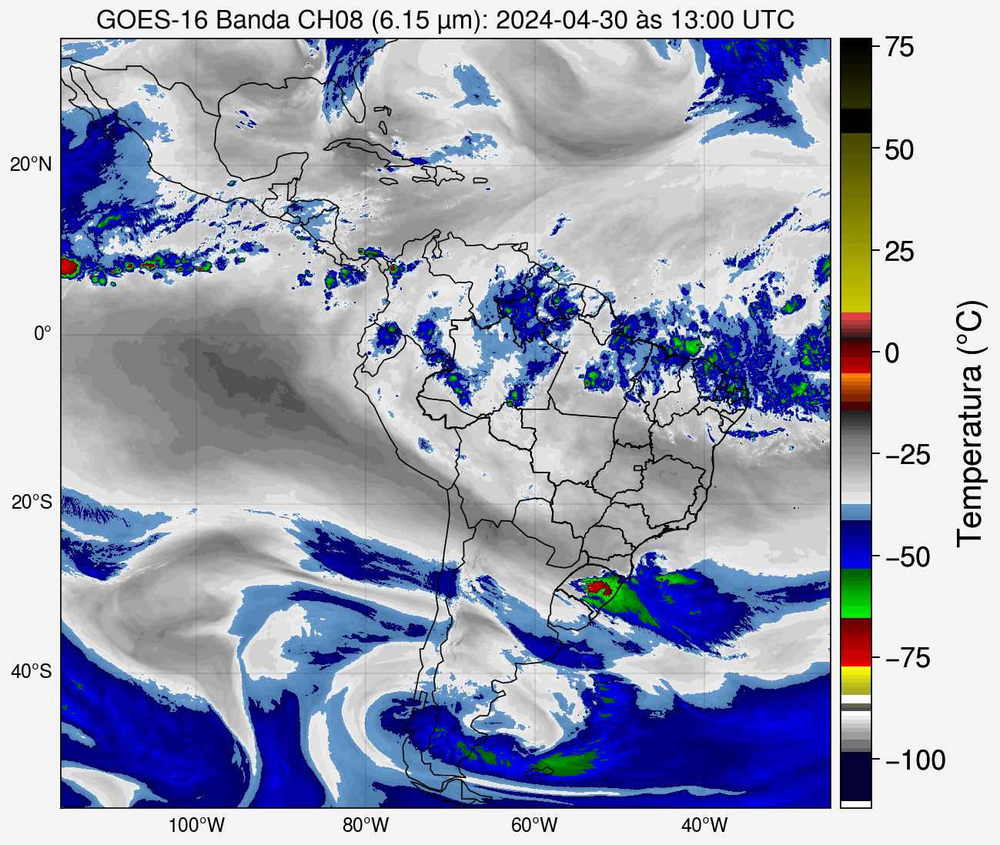

In [ ]:
# cria moldura da figura
fig, ax = pplt.subplots(axwidth=5, axheight=5, tight=True, proj='pcarree')

# define formato da figura
ax.format(coast=True, borders=True, innerborders=False,
          labels=True, latlines=20, lonlines=20,
          latlim=(latmin,latmax), lonlim=(lonmin,lonmax), fontsize=11,
          title=f'GOES-16 Banda CH08 (6.15 µm): {ano}-{mes}-{dia} às {hor}:{min} UTC')

# carrega tabela de cores
cpt_wv = loadCPT(f'/content/wv.cpt')
cmap_wv = cm.colors.LinearSegmentedColormap('cpt_wv', cpt_wv)

# plota mapa
map1 = ax.imshow(np.flipud(imagem),
                 cmap=cmap_wv,
                 extent=[lonmin, lonmax, latmin, latmax],
                 levels=pplt.arange(-112.15, 77.00, 1.0))

# plota contornos dos Estados
shapefile = list(shpreader.Reader('https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/shapefiles/BR_UF_2019.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='black', facecolor='none', linewidth=0.5)

# plota barra de cores da figura
fig.colorbar(map1, loc='r', label='Temperatura ($\degree$C)', ticks=25, ticklabelsize=13, labelsize=15, space=0.5)

# salva figura
fig.save(f'/content/output/script_4c_{ano}-{mes}-{dia}_{hor}:{min}.jpg', dpi=300, bbox_inches='tight')

# exibe a figura na tela
pplt.show()

#**Script 05** - Plotando o canal IR + VIS + WV com os dados do INPE - *Painel*

A ideia desse script é plotarmos as imagens do canal IR, VIS e WV numa mesma figuras. Isso facilita uma melhor comparação entre os três canais.

In [ ]:
#========================================================================================================================#
#                                             IMPORTA AS BIBLIOTECAS
#========================================================================================================================#
import numpy as np
import proplot as pplt
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import cm
import cartopy, cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
import xarray as xr
import os
from utilities import loadCPT
import warnings
warnings.filterwarnings("ignore")

#========================================================================================================================#
#                                         CRIA PASTA DE ENTRADA E SAÍDA
#========================================================================================================================#
input = "/content/input"; os.makedirs(input, exist_ok=True)
output = "/content/output"; os.makedirs(output, exist_ok=True)

#========================================================================================================================#
#                                         DEFINE A DATA DO ARQUIVO DE SATÉLITE
#========================================================================================================================#
ano, mes, dia, hor, min = '2024', '04', '30', '13', '00'

#========================================================================================================================#
#                                         BAIXA O ARQUIVO DE SATÉLITE
#========================================================================================================================#
# endereço do FTP do CPTEC-INPE
ftp_cptec = 'http://ftp.cptec.inpe.br/goes/'

# montando os nomes dos arquivos. É o caminho onde estão os dados no ftp do INPE.
file_ir =  f'{ftp_cptec}goes16/retangular/ch13/{ano}/{mes}/S10635346_{ano}{mes}{dia}{hor}{min}.nc'
file_vis = f'{ftp_cptec}goes16/retangular/ch02/{ano}/{mes}/S10635334_{ano}{mes}{dia}{hor}{min}.nc'
file_wv =  f'{ftp_cptec}goes16/retangular/ch08/{ano}/{mes}/S10635340_{ano}{mes}{dia}{hor}{min}.nc'

# download dos arquivos
!wget -c {file_ir} -P /content/input/
!wget -c {file_vis} -P /content/input/
!wget -c {file_wv} -P /content/input/

--2024-09-04 21:26:57--  http://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/2024/04/S10635346_202404301300.nc
Resolving ftp.cptec.inpe.br (ftp.cptec.inpe.br)... 150.163.192.38
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/2024/04/S10635346_202404301300.nc [following]
--2024-09-04 21:26:57--  https://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/2024/04/S10635346_202404301300.nc
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.

--2024-09-04 21:26:58--  http://ftp.cptec.inpe.br/goes/goes16/retangular/ch02/2024/04/S10635334_202404301300.nc
Resolving ftp.cptec.inpe.br (ftp.cptec.inpe.br)... 150.163.192.38
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|15

In [ ]:
# leitura dos dados
imagem_ir = xr.open_dataset(f'/content/input/S10635346_{ano}{mes}{dia}{hor}{min}.nc')
imagem_vis = xr.open_dataset(f'/content/input/S10635334_{ano}{mes}{dia}{hor}{min}.nc')
imagem_wv = xr.open_dataset(f'/content/input/S10635340_{ano}{mes}{dia}{hor}{min}.nc')

# organiza os dados
imagem_ir = (imagem_ir['Band1']/100.)-273.15
imagem_vis = (imagem_vis['Band1']/100.)
imagem_wv = (imagem_wv['Band1']/100.)-273.15

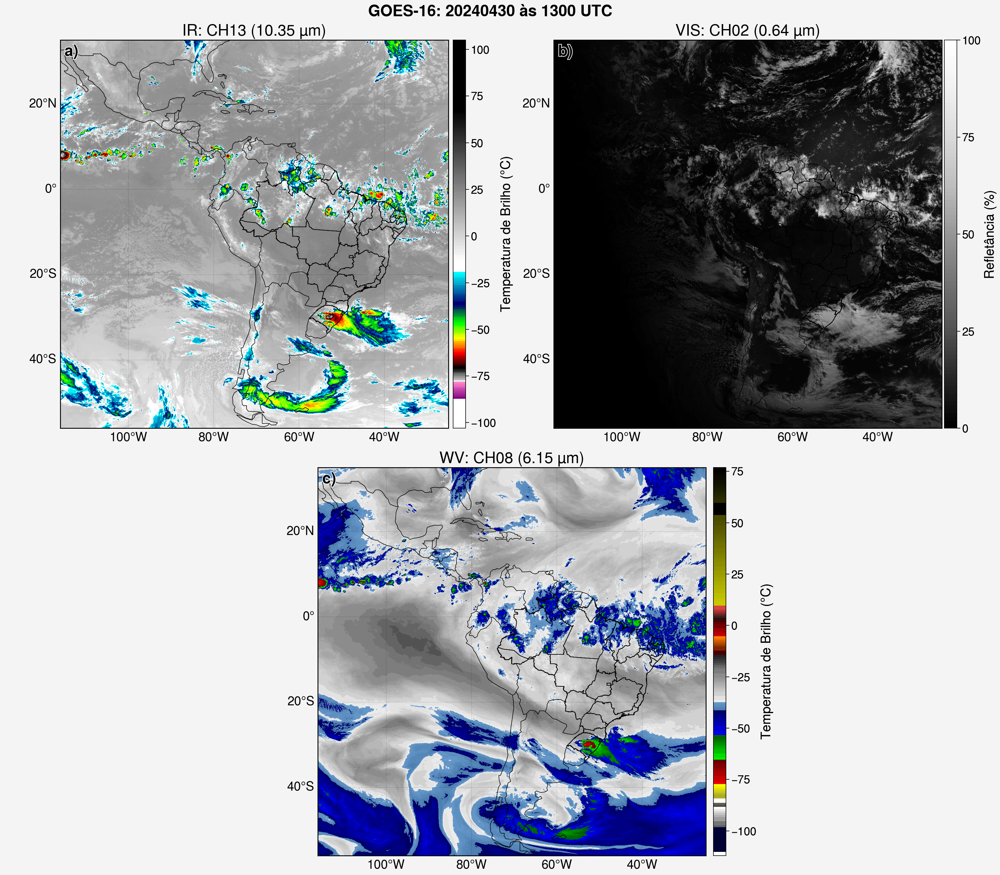

CPU times: user 35 s, sys: 3.43 s, total: 38.4 s
Wall time: 36.7 s


In [ ]:
%%time
#========================================================================================================================#
#                                               CONFIGURAÇÕES DO MAPA
#========================================================================================================================#
# cria a moldura da figura
fig, ax = pplt.subplots([[1, 1, 2, 2], [0, 3, 3, 0]], figsize=(16,14), tight=True, proj='pcarree', sharex= False, sharey = False)

# formatação dos eixos
ax.format(coast=True, borders=True, innerborders=False,
          labels=False,
          latlines=20, lonlines=20,
          latlim=(latmin,latmax), lonlim=(lonmin,lonmax),
          suptitle=f'GOES-16: {ano}{mes}{dia} às {hor}{min} UTC',
          abc=True, abcstyle='a)', abcsize=5, abcloc = 'ul',
          small='20px', large='25px')

# define qual eixo terá os labels de latitudes e longitudes
ax[0].format(labels = [True, False, True, False])
ax[1].format(labels = [False, False, True, False])
ax[2].format(labels = [False, False, True, False])

#========================================================================================================================#
#                                                FIGURA 1: IR
#========================================================================================================================#
# carrega tabela de cores
cpt_ir = loadCPT(f'/content/ir.cpt')
cmap_ir = cm.colors.LinearSegmentedColormap('cpt_ir', cpt_ir)

# plota mapa
map1 =  ax[0].imshow(np.flipud(imagem_ir),
                    cmap=cmap_ir,
                    extent=[lonmin, lonmax, latmin, latmax],
                    levels=pplt.arange(-103.0, 105, 1.0))

# plota contornos dos Estados
shapefile = list(shpreader.Reader('https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/shapefiles/BR_UF_2019.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='black', facecolor='none', linewidth=0.5)

# plota titulo de cada figura
ax[0].format(title='IR: CH13 (10.35 µm)', labels=True, linewidth=1)

# plota barra de cores da figura
ax[0].colorbar(map1, loc='r', label='Temperatura de Brilho ($\degree$C)', ticks=25, ticklabelsize=13, labelsize=15, space=-7.1)

#========================================================================================================================#
#                                                       FIGURA 2: VIS
#========================================================================================================================#
# plota mapa
map2 = ax[1].imshow(np.flipud(imagem_vis),
             cmap='Greys_r',
             extent=[lonmin, lonmax, latmin, latmax],
             levels=pplt.arange(0, 100, 1.0))

# plota contornos dos Estados
shapefile = list(shpreader.Reader('https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/shapefiles/BR_UF_2019.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='black', facecolor='none', linewidth=0.5)

# plota titulo de cada figura
ax[1].format(title='VIS: CH02 (0.64 µm)', labels=True, linewidth=1)

# plota barra de cores da figura
ax[1].colorbar(map2, loc='r', label='Refletância (%)', ticks=25, ticklabelsize=13, labelsize=15, space=-4.6)

#========================================================================================================================#
#                                                    FIGURA 3: WV
#========================================================================================================================#
# carrega tabela de cores
cpt_wv = loadCPT(f'/content/wv.cpt')
cmap_wv = cm.colors.LinearSegmentedColormap('cpt_wv', cpt_wv)

# plota mapa
map3 = ax[2].imshow(np.flipud(imagem_wv),
             cmap=cmap_wv,
             extent=[lonmin, lonmax, latmin, latmax],
             levels=pplt.arange(-112.15, 77.00, 1.0))

# plota contornos dos Estados
shapefile = list(shpreader.Reader('https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/shapefiles/BR_UF_2019.shp').geometries())
ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='black', facecolor='none', linewidth=0.5)

# plota titulo de cada figura
ax[2].format(title="WV: CH08 (6.15 µm)", labels=True, linewidth=1)

# plota barra de cores da figura
ax[2].colorbar(map3, loc='r', label='Temperatura de Brilho ($\degree$C)', ticks=25, ticklabelsize=13, labelsize=15, space=-7.2)
#-------------------------------#

# salva figura
fig.save(f'/content/output/script_5_{ano}-{mes}-{dia}_{hor}:{min}.jpg', dpi=300, bbox_inches='tight')

# exibe a figura na tela
pplt.show()

#**Script 06** - Plotando várias imagens do IR e criando animação

- No exemplo anterior plotamos apenas uma única imagem. Porém, se quisermos produzir 5, 10 ou 20 imagens, como poderíamos fazer? Teríamos que mudar o horário e produzir uma de cada vez?
- Para isto usaremos o conceito de loop. Usaremos uma estrutura de repetição, nesse caso será o comando **for** do python. Maiores informações sobre o comando for acesse [aqui](https://pythonacademy.com.br/blog/estruturas-de-repeticao#:~:text=O%20for%20%C3%A9%20utilizado%20para,utilizando%20for%20n%C3%A3o%20%C3%A9%20diferente.).
- Antes de usar o Loop precisaremos indicar para o computador quais arquivos serão lidos. Assim teremos que montar uma lista com os nomes desses arquivos, e para isto usaremos o comando [**glob**](https://pt.linuxteaching.com/article/python_glob_function#what_is_the_glob_function_in_python).

In [ ]:
%%time
#========================================================================================================================#
#                                             IMPORTA AS BIBLIOTECAS
#========================================================================================================================#
import numpy as np
import proplot as pplt
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import cm
import cartopy, cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
import xarray as xr
import os
import pandas as pd
from utilities import loadCPT
import imageio
import glob
import warnings
warnings.filterwarnings("ignore")

#========================================================================================================================#
#                                         CRIA PASTA DE ENTRADA E SAÍDA
#========================================================================================================================#
input = "/content/input"; os.makedirs(input, exist_ok=True)
output = "/content/output"; os.makedirs(output, exist_ok=True)

#========================================================================================================================#
#                                         BAIXANDO OS ARQUIVOS DE SATÉLITE
#========================================================================================================================#
# loop dos arquivos
files_ir = []
for file in pd.date_range('202404301300', '202404301500', freq='10min'):

    # extrai ano e mes
    ano = file.strftime('%Y')
    mes = file.strftime('%m')
    dia = file.strftime('%d')
    hor = file.strftime('%H')
    min = file.strftime('%M')

    # endereço do FTP do CPTEC-INPE
    ftp_cptec = 'http://ftp.cptec.inpe.br/goes/'

    # montando os nomes dos arquivos. É o caminho onde estão os dados no ftp do INPE.
    file_ir =  f'{ftp_cptec}goes16/retangular/ch13/{ano}/{mes}/S10635346_{ano}{mes}{dia}{hor}{min}.nc'

    print("#==========================================================================================================#")
    print('                          Baixando arquivo', f'S10635346_{ano}{mes}{dia}{hor}{min}.nc')
    print("#==========================================================================================================#",'\n')

    # download dos arquivos
    !wget -c {file_ir} -P /content/input/

    # lista dos arquivos
    files_ir.append(f'S10635346_{ano}{mes}{dia}{hor}{min}.nc')
#files_ir = files_ir[0:1]

#==========================================================================================================#
                          Baixando arquivo S10635346_202404301300.nc
#==========================================================================================================# 

--2024-09-04 21:32:34--  http://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/2024/04/S10635346_202404301300.nc
Resolving ftp.cptec.inpe.br (ftp.cptec.inpe.br)... 150.163.192.38
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/2024/04/S10635346_202404301300.nc [following]
--2024-09-04 21:32:35--  https://ftp.cptec.inpe.br/goes/goes16/retangular/ch13/2024/04/S10635346_202404301300.nc
Connecting to ftp.cptec.inpe.br (ftp.cptec.inpe.br)|150.163.192.38|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable



....PROCESSANDO--->>> S10635346_202404301300.nc
....PROCESSANDO--->>> S10635346_202404301310.nc
....PROCESSANDO--->>> S10635346_202404301320.nc
....PROCESSANDO--->>> S10635346_202404301330.nc
....PROCESSANDO--->>> S10635346_202404301340.nc
....PROCESSANDO--->>> S10635346_202404301350.nc
....PROCESSANDO--->>> S10635346_202404301400.nc
....PROCESSANDO--->>> S10635346_202404301410.nc
....PROCESSANDO--->>> S10635346_202404301420.nc
....PROCESSANDO--->>> S10635346_202404301430.nc
....PROCESSANDO--->>> S10635346_202404301440.nc
....PROCESSANDO--->>> S10635346_202404301450.nc
....PROCESSANDO--->>> S10635346_202404301500.nc
CPU times: user 55.4 s, sys: 5.39 s, total: 1min
Wall time: 56.7 s


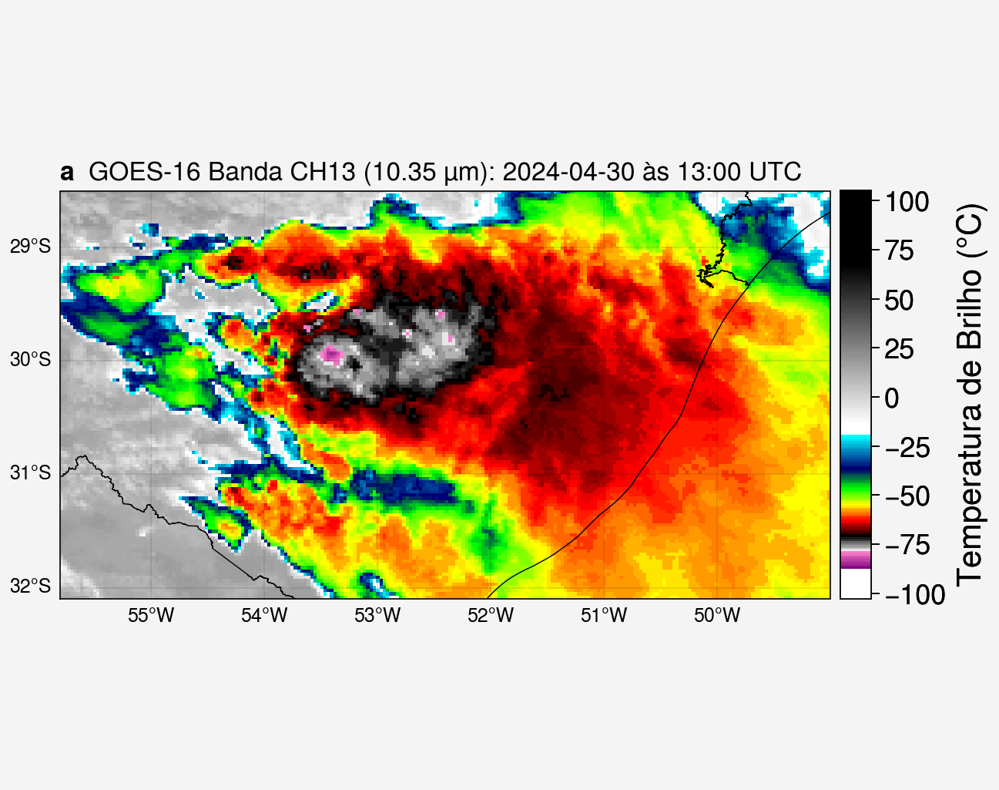

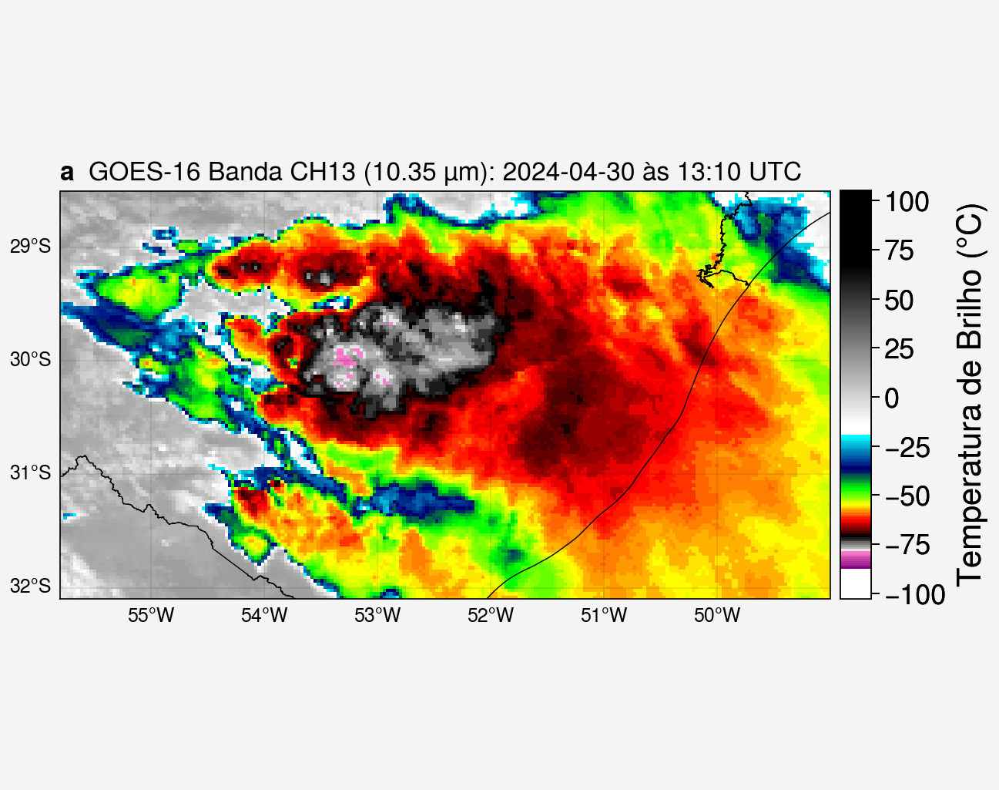

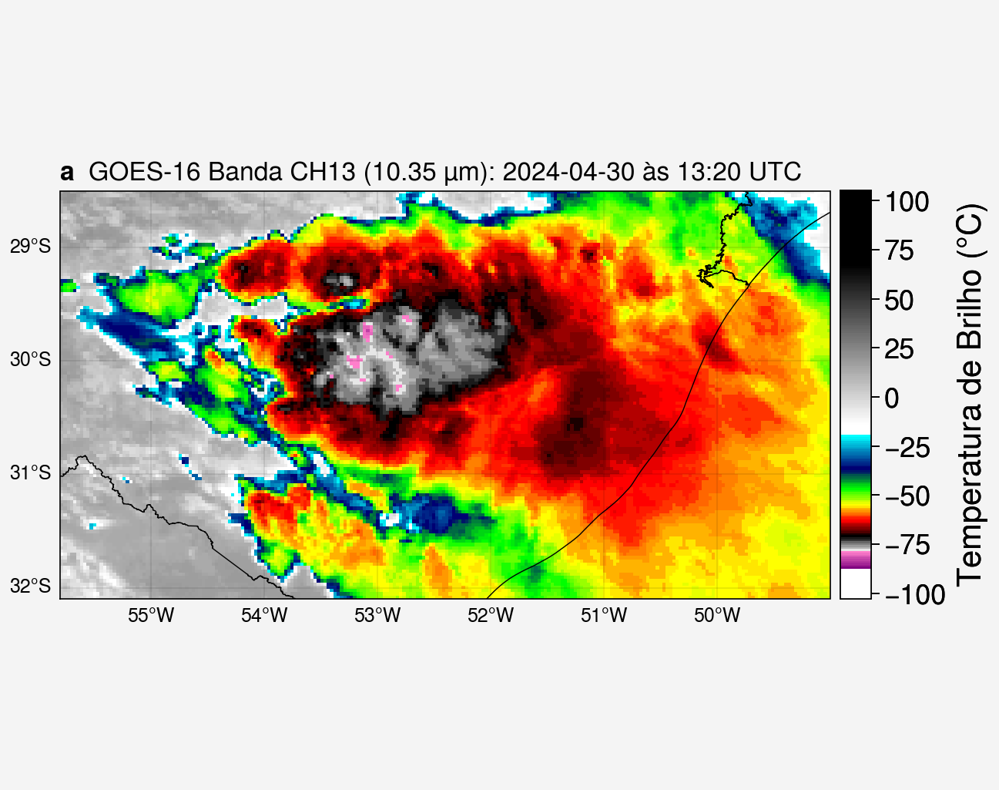

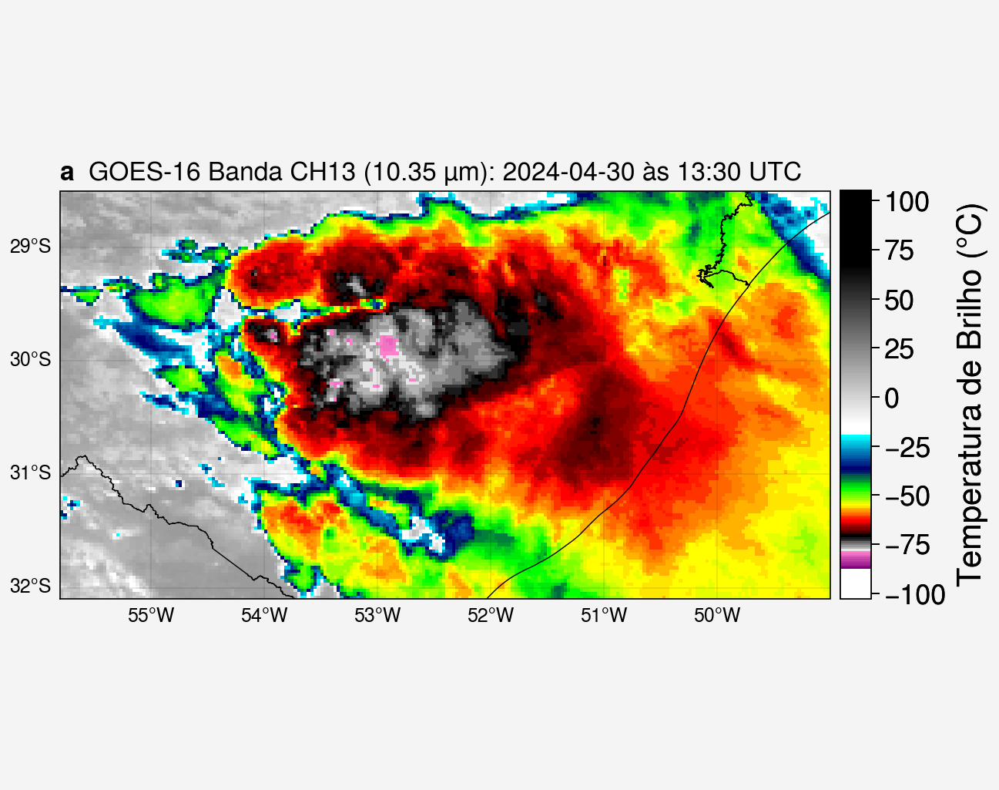

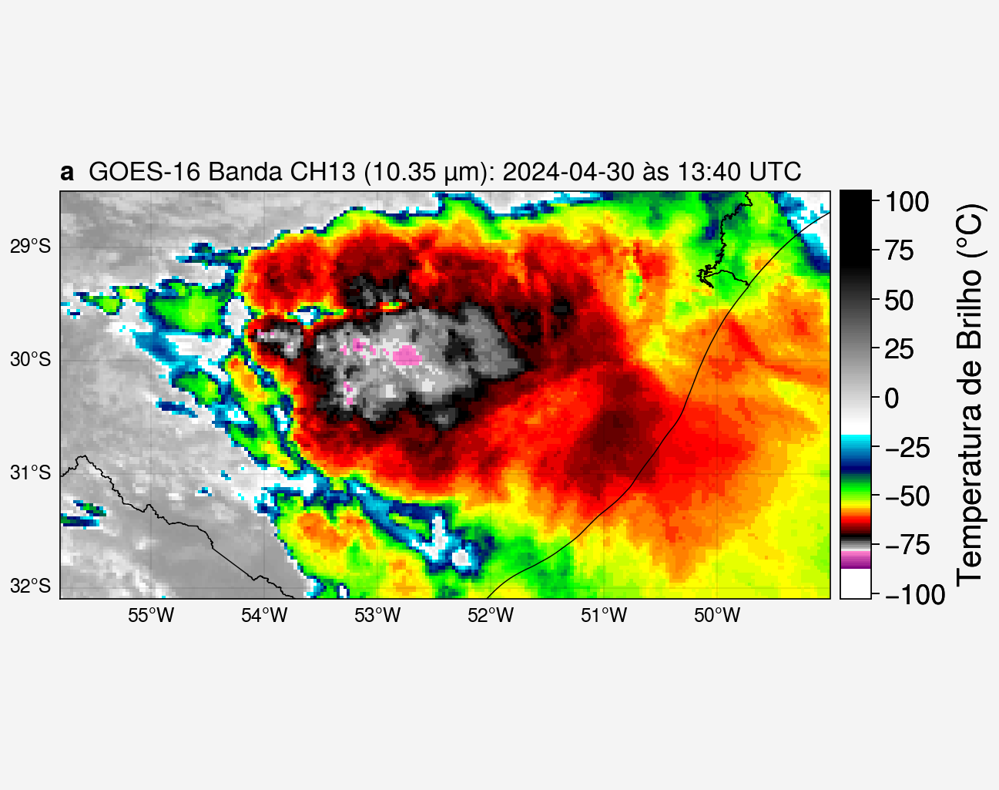

...

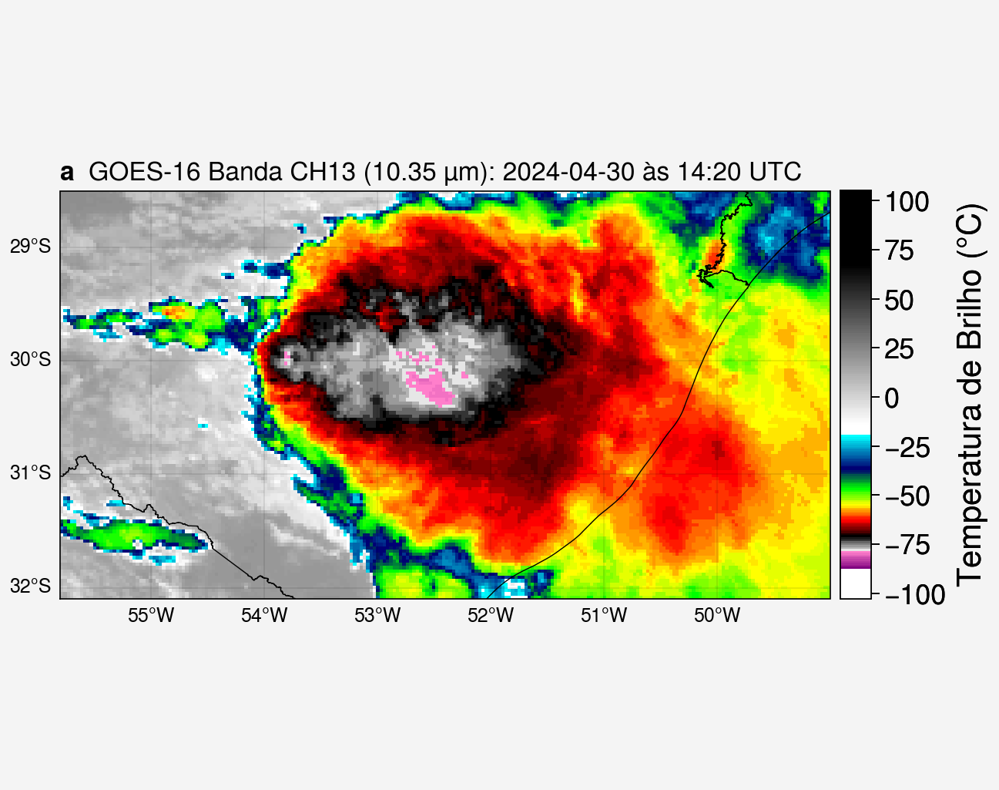

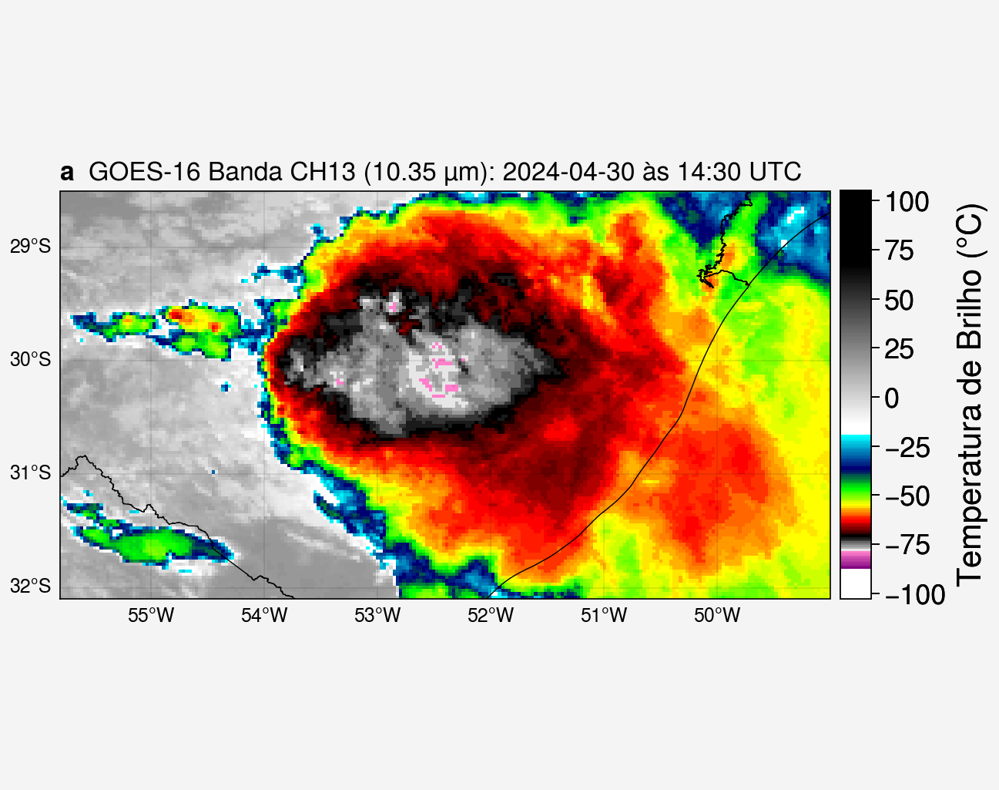

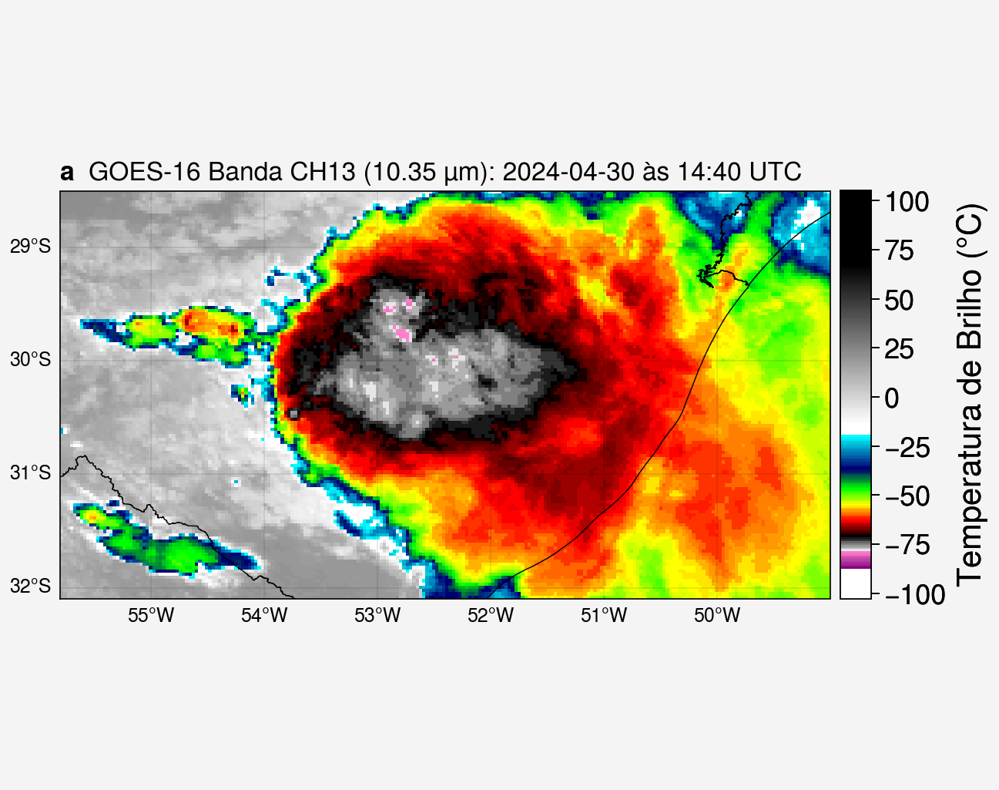

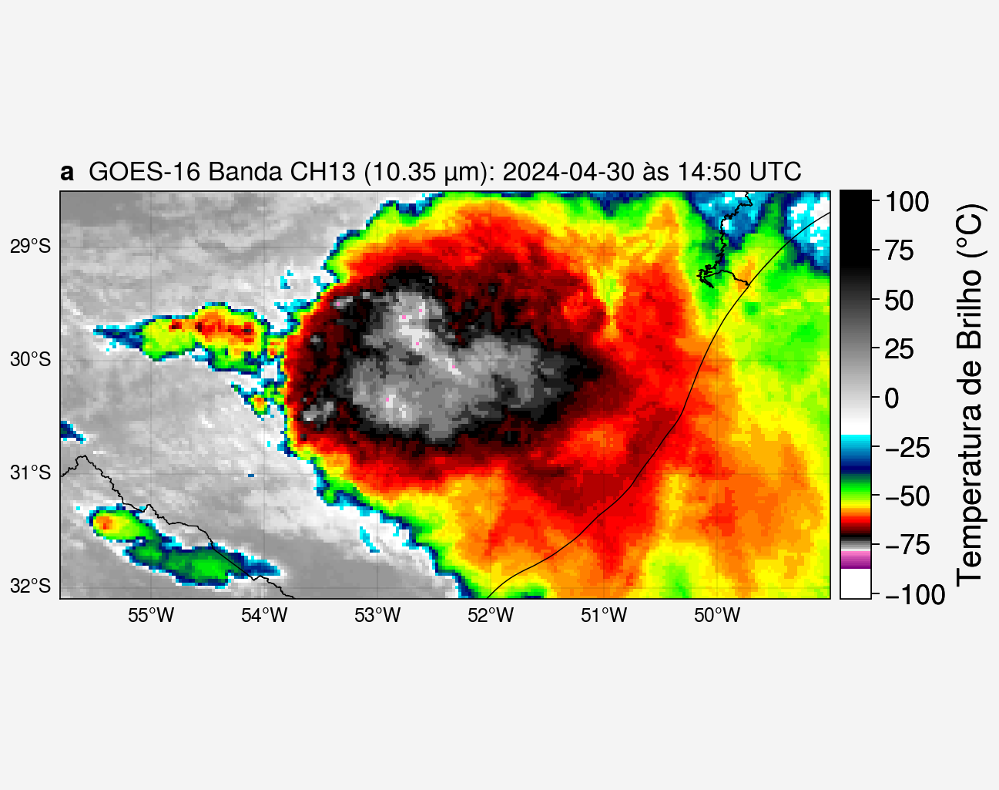

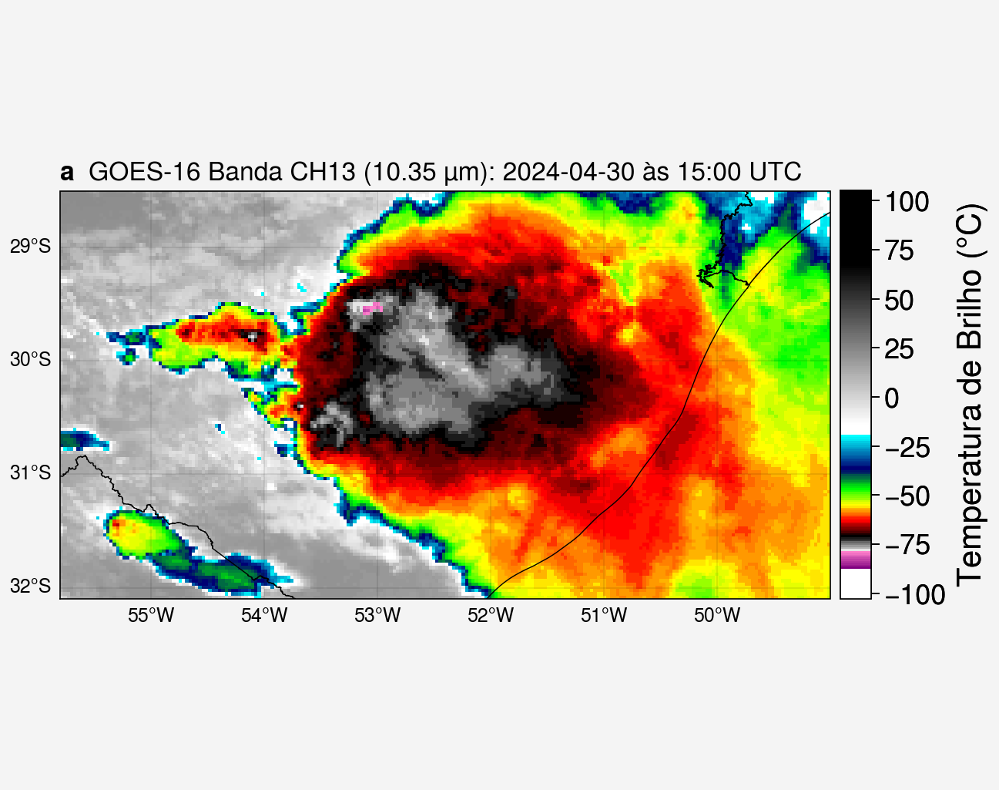

In [ ]:
%%time
# Loop das imagens
for file in files_ir:

    print('....PROCESSANDO--->>>', file)

    #------------------------------------#
    #      Leitura do dado
    #------------------------------------#
    # extrai a data da imagem
    ano, mes, dia, hor, min = file[10:14], file[14:16], file[16:18], file[18:20], file[20:22]

    # limites da imagem
    lonmin, lonmax, latmin, latmax = -55.8, -49.0, -32.1, -28.5

    # leitura do arquivo NetCdf
    imagem = xr.open_dataset(f'/content/input/{file}').sel(lon=slice(lonmin, lonmax), lat=slice(latmin, latmax))

    # Divide por 100 e transforma para Celsius
    imagem = (imagem['Band1']/100.) - 273.15

    #------------------------------------#
    #          Plotando a figura
    #------------------------------------#
    # cria a moldura da figura
    fig, ax = pplt.subplots(axwidth=5, axheight=5, tight=True, proj='pcarree')

    # define formato da figura
    ax.format(coast=False, borders=False, innerborders=False,
              labels=True, latlines=1, lonlines=1,
              latlim=(latmin,latmax), lonlim=(lonmin,lonmax), fontsize=11,
              title=f'GOES-16 Banda CH13 (10.35 µm): {ano}-{mes}-{dia} às {hor}:{min} UTC')

    # carrega tabela de cores
    cpt_ir = loadCPT(f'/content/ir.cpt')
    cmap_ir = cm.colors.LinearSegmentedColormap('cpt_ir', cpt_ir)

    # plota mapa
    map1 = ax.imshow(np.flipud(imagem),
                     cmap=cmap_ir,
                     extent=[lonmin, lonmax, latmin, latmax],
                     levels=pplt.arange(-103.0, 105, 1.0))

    # plota contornos dos Estados
    shapefile = list(shpreader.Reader('https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/shapefiles/BR_UF_2019.shp').geometries())
    ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='black', facecolor='none', linewidth=0.5)

    # plota barra de cores da figura
    fig.colorbar(map1, loc='r', label='Temperatura de Brilho ($\degree$C)', ticks=25, ticklabelsize=13, labelsize=15, space=0.5, length=0.53)

    # salva figura
    fig.save(f'/content/output/script_6_{ano}-{mes}-{dia}_{hor}:{min}.jpg', dpi=300, bbox_inches='tight')

- O objetivo aqui é montar uma animação com as imagens de satélites que foram geradas na pasta **output**. Para isto usaremos a biblioteca [imageio](https://imageio.readthedocs.io/en/stable/).


Abrindo o GIF..



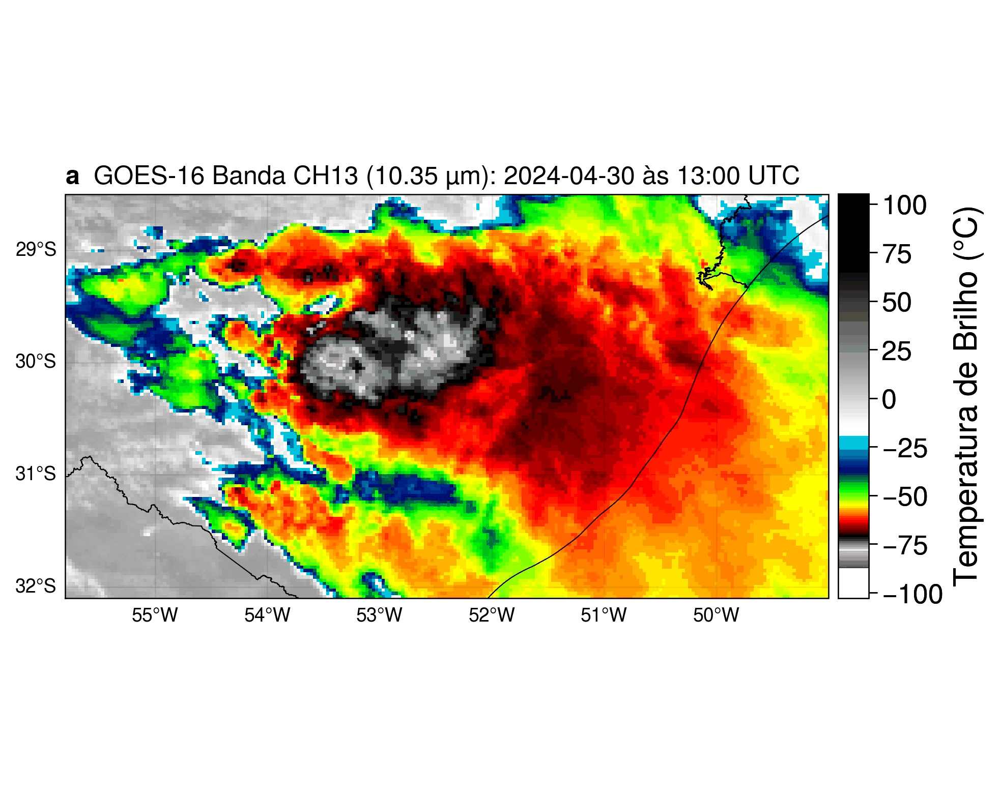

In [ ]:
# monta lista dos arquivos
files = sorted(glob.glob(f'/content/output/script_6*.jpg'))

# cria uma lista com as imagens
images = []
for file in files:
    images.append(imageio.imread(file))

# salva em formato de animação de imagens
imageio.mimsave(f'/content/output/script_6_animacao_imagens.gif',
                images,
                duration=500,
                loop=0)

# mostrando a animação na tela
print("\nAbrindo o GIF..\n")

from IPython.display import Image

Image(open(f'/content/output/script_6_animacao_imagens.gif','rb').read(), width=600)

# **Script 07** - Plotando painel


- É comum termos que mostrar várias imagens em apenas uma figura, em forma de painel. Nesse exemplo, aprenderemos como plotar 12 imagens em uma única figura.

....PROCESSANDO--->>> S10635346_202404301300.nc
....PROCESSANDO--->>> S10635346_202404301310.nc
....PROCESSANDO--->>> S10635346_202404301320.nc
....PROCESSANDO--->>> S10635346_202404301330.nc
....PROCESSANDO--->>> S10635346_202404301340.nc
....PROCESSANDO--->>> S10635346_202404301350.nc
....PROCESSANDO--->>> S10635346_202404301400.nc
....PROCESSANDO--->>> S10635346_202404301410.nc
....PROCESSANDO--->>> S10635346_202404301420.nc
....PROCESSANDO--->>> S10635346_202404301430.nc
....PROCESSANDO--->>> S10635346_202404301440.nc
....PROCESSANDO--->>> S10635346_202404301450.nc
CPU times: user 1min 12s, sys: 8.14 s, total: 1min 20s
Wall time: 1min 17s


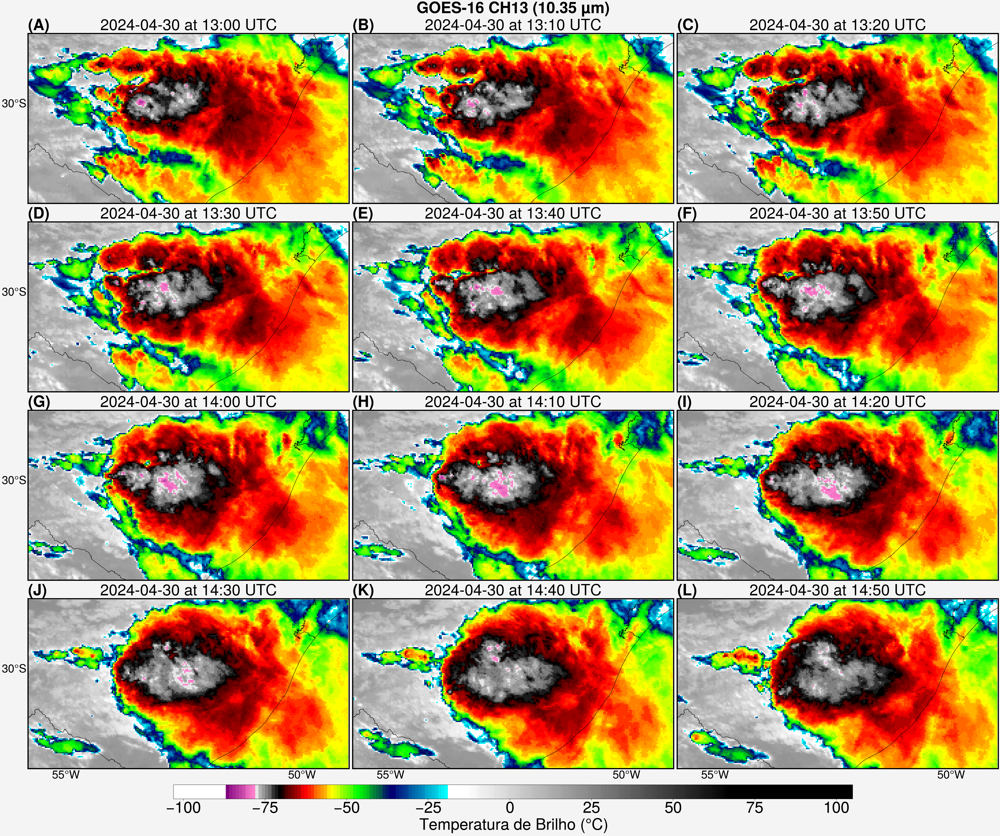

In [ ]:
%%time
#========================================================================================================================#
#                                             IMPORTA AS BIBLIOTECAS
#========================================================================================================================#
import proplot as pplt
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import cm
import cartopy, cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
import xarray as xr
from utilities import loadCPT
import warnings
warnings.filterwarnings("ignore")

#========================================================================================================================#
#                                            ARQUIVOS A SEREM PLOTADOS
#========================================================================================================================#
# lista dos arquivos a serem plotados
files = ['S10635346_202404301300.nc',
         'S10635346_202404301310.nc',
         'S10635346_202404301320.nc',
         'S10635346_202404301330.nc',
         'S10635346_202404301340.nc',
         'S10635346_202404301350.nc',
         'S10635346_202404301400.nc',
         'S10635346_202404301410.nc',
         'S10635346_202404301420.nc',
         'S10635346_202404301430.nc',
         'S10635346_202404301440.nc',
         'S10635346_202404301450.nc']

#========================================================================================================================#
#                                                  PLOTA FIGURA
#========================================================================================================================#
# cria moldura da figura
fig, ax = pplt.subplots(ncols=3, nrows=4, axheight=6, tight=True, proj='pcarree')

# formatação dos eixos
ax.format(coast=False, borders=False, innerborders=False,
          labels=True, latlines=5, lonlines=5,
          latlim=(latmin, latmax), lonlim=(lonmin, lonmax),
          abc=True, abcstyle='(A)', abcsize=15,
          small='40px', large='55px',
          suptitle='GOES-16 CH13 (10.35 µm)')

# carrega tabela de cores
cpt_ir = loadCPT(f'/content/ir.cpt')
cmap_ir = cm.colors.LinearSegmentedColormap('cpt_ir', cpt_ir)

# loop das imagens
for i, file in enumerate(files):

    print('....PROCESSANDO--->>>', file)

    #------------------------------------#
    #      Leitura do dado
    #------------------------------------#
    # extrai a data da imagem
    ano, mes, dia, hor, min = file[10:14], file[14:16], file[16:18], file[18:20], file[20:22]

    # limites da imagem
    lonmin, lonmax, latmin, latmax = -55.8, -49.0, -32.1, -28.5

    # leitura do arquivo NetCdf
    imagem = xr.open_dataset(f'/content/input/{file}').sel(lon=slice(lonmin, lonmax), lat=slice(latmin, latmax))

    # Divide por 100 e transforma para Celsius
    imagem = (imagem['Band1']/100.)-273.15

    # Extrai os limites das latitudes e longitudes
    latmin, latmax, lonmin, lonmax = float(imagem['lat'][0]), float(imagem['lat'][-1]), float(imagem['lon'][0]), float(imagem['lon'][-1])

    #------------------------------------#
    #          Plotando a figura
    #------------------------------------#
    if i == 0:
        map1 = ax[i].imshow(np.flipud(imagem),
                     cmap=cmap_ir,
                     extent=[lonmin, lonmax, latmin, latmax],
                     levels=pplt.arange(-103.0, 105, 1.0))
    else:
        ax[i].imshow(np.flipud(imagem),
                     cmap=cmap_ir,
                     extent=[lonmin, lonmax, latmin, latmax],
                     levels=pplt.arange(-103.0, 105, 1.0))

    # plota contornos dos Estados
    shapefile = list(shpreader.Reader('https://github.com/evmpython/CAT010_UNIFEI_2024/raw/main/shapefiles/BR_UF_2019.shp').geometries())
    ax.add_geometries(shapefile, ccrs.PlateCarree(), edgecolor='black', facecolor='none', linewidth=0.5)

    # plota titulo de cada figura
    if (i==1 or i==2 or i==4 or i==5 or i==7 or i==8): ax[i].format(title=f'{ano}-{mes}-{dia} at {hor}:{min} UTC', labels=False, linewidth=3)
    if (i==10 or i==11): ax[i].format(title=f'{ano}-{mes}-{dia} at {hor}:{min} UTC', labels=[False, False, True, False], linewidth=3)
    if (i==0 or i==3 or i==6): ax[i].format(title=f'{ano}-{mes}-{dia} at {hor}:{min} UTC', labels=[True, False, False, False], linewidth=3)
    if (i==9): ax[i].format(title=f'{ano}-{mes}-{dia} at {hor}:{min} UTC', labels=[True, False, True, False], linewidth=3)

# plota barra de cores
fig.colorbar(map1, loc='b', label='Temperatura de Brilho ($\degree$C)', ticks=25, ticklabelsize=40, labelsize=40, width=0.5, length=0.7)

# sala figura
fig.save(f'/content/output/script_7_painel.jpg', dpi=300, bbox_inches='tight')